### Characterizing bursting dynamics of links (plotting results)

In [1]:
# Path to the toolbox
import sys; sys.path.insert(1, '/home/vinicius/storage1/projects/GrayData-Analysis')
import os 

# GDa functions
import GDa.stats.bursting                as     bst
from   GDa.session                       import session
from   GDa.temporal_network              import temporal_network

import matplotlib.pyplot                 as     plt
import matplotlib
import GDa.graphics.plot                 as     plot

from   mne.viz                           import circular_layout, \
                                                plot_connectivity_circle

import numpy                             as     np
import xarray                            as     xr

from   tqdm                              import tqdm
from   sklearn.manifold                  import TSNE
from   scipy                             import stats

#### Plotting and file saving configurations

In [2]:
SMALL_SIZE, MEDIUM_SIZE, BIGGER_SIZE = plot.set_plot_config()

In [3]:
# Create directory to save figures
if not os.path.exists("img/n5.0.0"):
    os.makedirs("img/n5.0.0")

In [4]:
# Bands names
band_names  = [r'band 1', r'band 2', r'band 3', r'band 4', r'band 5']
stages      = ['baseline', 'cue', 'delay', 'match']
_stats      = [r"$\mu$","std$_{\mu}$",r"$\mu_{tot}$","CV"]

In [251]:
### Methods to read coherence files
def get_coh_file(ks=None, surr=False, mode="morlet"):
    if not surr:
        _COH_FILE = f'coh_k_{ks}_{mode}.nc'
    else:
        _COH_FILE = f'coh_k_{ks}_{mode}_surr.nc'
    return _COH_FILE

### Methods to read burst stats files
def get_bst_file(ks=None, mode="morlet"):
        return f'~/storage1/projects/GrayData-Analysis/Results/lucy/141017/session01/bs_stats_k_{ks}_numba_{mode}.nc'

In [6]:
# Parameters to read the data
idx      = 3 
nses     = 1
nmonkey  = 0
align_to = 'cue'

dirs = { 'rawdata':'/home/vinicius/storage1/projects/GrayData-Analysis/GrayLab',
         'results':'Results/',
         'monkey' :['lucy', 'ethyl'],
         'session':'session01',
         'date'   :[['141014', '141015', '141205', '141017','150128', '150211', '150304'], []] }

In [7]:
###################################################################################
# Instantiate network to get parameters
###################################################################################

net =  temporal_network(coh_file=get_coh_file(ks=0.3, surr=False, mode="morlet"), 
                        coh_sig_file=get_coh_file(ks=0.3, surr=True, mode="morlet"), 
                        date='141017', trial_type=[1], behavioral_response=[1])

### Visualizing the super tensor

#### Loading session and setting coherence parameters

In [8]:
#  Instantiating session
ses   = session(raw_path = dirs['rawdata'], monkey ='lucy', date ='141017',
                session = nses, slvr_msmod = True, align_to = align_to, evt_dt = [-0.65, 3.00])
# Load data
ses.read_from_mat()

In [9]:
sm_times  = 0.3 # In seconds
sm_freqs  = 1 
sm_kernel = "square"

# Defining parameters
delta  = 15       # Downsampling factor
mode   = 'morlet' # ("morlet", "mt_1", "mt_2")
#  mode  = 'multitaper' # ("morlet", "mt_1", "mt_2")
foi   = np.array([
    [0, 6.],
    [6., 14.],
    [14., 26.],
    [26., 42.],
    [42., 80.]
        ])

freqs = np.linspace(3,75,10)

n_cycles     = freqs/2
mt_bandwidth = None

When instantiated, the temporal network object will load the recording info for the monkey, date, and session specified as well as the super tensor; The trial type and the behavioral response can also be specified.

The super-tensor has dimensions [Number of pairs, Number of frequency bands, Number of trials, Time]. For Lucy the frequency bands analysed are:

- band $1$  = [0.1,6]  Hz;
- band $2$  = [6,14]   Hz;
- band $3$  = [14,26]  Hz;
- band $4$  = [26,42]  Hz;
- band $5$  = [42,80]  Hz;

The __temporal_network__ class can also be instantiated by setting threshold as __True__ this will automatically threshold the super-tensor (computed for all trial types independent on how the trial type parameter was set).

### Panel with supertensor, ERP and t-sne projection (q=0.8)

In the cells bellow we perform the burstness analysis for the default thresholding parameter.

In [10]:
def plot_erp(ax, coh, i):
    """
    Plot ERP at axis ax, i is used to index a specific frequency band
    """
    plt.sca(ax)
    # Average activation sequences over links
    mu_filtered_super_tensor = coh.mean(dim=('roi'))
    for t in range(net.super_tensor.shape[2]):
        plt.plot(net.time, 
        mu_filtered_super_tensor.isel(trials=t).values, 
        color='b', lw=.1)
    plt.plot(net.time, 
             mu_filtered_super_tensor.median(dim='trials'),
            color='k', lw=3)
    plt.plot(net.time, 
         mu_filtered_super_tensor.quantile(q=5/100,dim='trials'),
        color='r', lw=3)
    plt.plot(net.time, 
    mu_filtered_super_tensor.quantile(q=95/100,dim='trials'),
    color='r', lw=3)
    plt.xlim([net.time[0],net.time[-1]])

def plot_tsne(ax, coh, i):
    """
    Plot the t-sne projection at axis ax, i is used to index a specific frequency band
    """
    plt.sca(ax)
    aux = coh.isel(trials=slice(0,50))
    aux = aux.stack(observations=("trials","times"))
    Y = TSNE(n_components=2, 
             metric='hamming', 
             perplexity=30.0,
             square_distances=True,
             n_jobs=20).fit_transform(aux.T)
    for i in range(len(stages)):
        plt.plot(Y[net.s_mask[stages[i]][:50*len(net.time)],0], 
                 Y[net.s_mask[stages[i]][:50*len(net.time)],1], 
                 '.', ms=2, label = stages[i])
        plt.legend()

In [13]:
def plot_erp_panel(_KS=0.3, _REL=False, title=None):
    # Instantiate network
    q_thr = 0.8

    # Instantiating a temporal network object without thresholding the data
    #net =  temporal_network(coh_file=get_coh_file(ks=_KS, surr=_SURR, mode=mode), monkey=dirs['monkey'][nmonkey], 
    #                        session=1, date='141017', trial_type=[1],
    #                        behavioral_response=[1], wt=(20,20), drop_trials_after=True,
    #                        verbose=True, **kw)
    coh = (net.super_tensor.sel(freqs=slice(6,14)).mean("freqs"))>0#net.get_thresholded_coherence(q_thr, _REL, True).sel(freqs=slice(6,14)).mean("freqs")
    # Mask to track observations within a task-stage
    net.create_stage_masks(flatten=True)

    
    # Plot panel
    fig = plt.figure(figsize=(10, 7), dpi=600)

    gs1 = fig.add_gridspec(nrows=1, ncols=1, left=0.05, right=0.95, bottom=0.5, top=0.90)
    gs2 = fig.add_gridspec(nrows=1, ncols=3, width_ratios=(1,0.001,0.6), left=0.05, right=0.95, bottom=0.08, top=0.4)
    # Panel A
    ax1 = plt.subplot(gs1[0])
    plt.sca(ax1)
    plt.imshow(coh[:,:10,:].stack(observations=('trials','times')), 
               aspect = 'auto', cmap = 'gray', origin = 'lower', 
               extent = [0, 10*len(net.time), 1, net.super_tensor.sizes['roi']], vmin=0, vmax=1)
    plt.title(title, fontsize=MEDIUM_SIZE)
    plt.ylabel("Edge index", fontsize=SMALL_SIZE)
    plt.xlabel('Time [a.u]', fontsize=SMALL_SIZE)
    # Panel B
    ax2 = plt.subplot(gs2[0])
    ax3 = plt.subplot(gs2[2])

    plot_erp(ax2,  coh, 1)
    plt.ylabel(r'$\langle C_{ij} \rangle$', fontsize=SMALL_SIZE)
    plt.xlabel('Time [s]', fontsize=SMALL_SIZE)
    #plot_tsne(ax3, coh, 1)
    plt.xticks([])
    plt.yticks([])
    plt.xlabel(r"tsne$_x$")
    plt.ylabel(r"tsne$_y$")

    bg = plot.Background(visible=False)
    plot.add_panel_letters(fig, axes=[ax1, ax2, ax3], fontsize=18,
                           xpos=[-0.045,-0.1,-0.13], ypos=[1.0, 1.0, 1.0]);
    
    #bg.axes.text(0.50, 1.0, title, ha='center', fontsize=MEDIUM_SIZE)

    plt.savefig(f"img/n5.0.0/figure0_ks_{_KS}_rel_{_REL}_{mode}.png")

#### Absolute threshold (q=0.8)

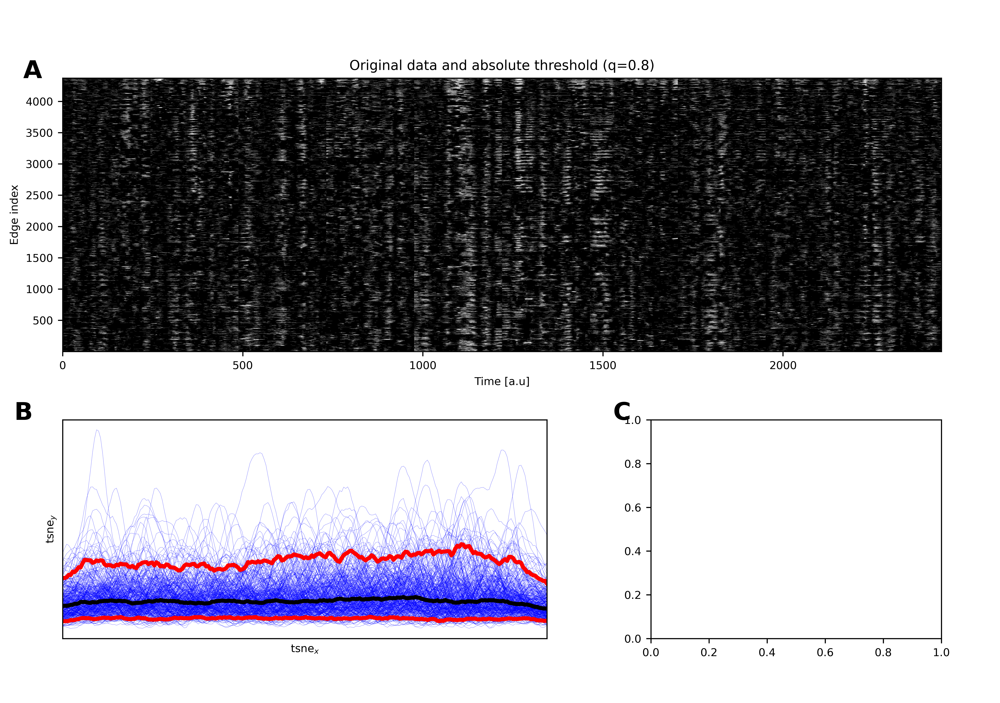

In [14]:
plot_erp_panel(_KS=0.3, _REL=False, title=r"Original data and absolute threshold (q=0.8)")

#### Relative threshold (q=0.8)

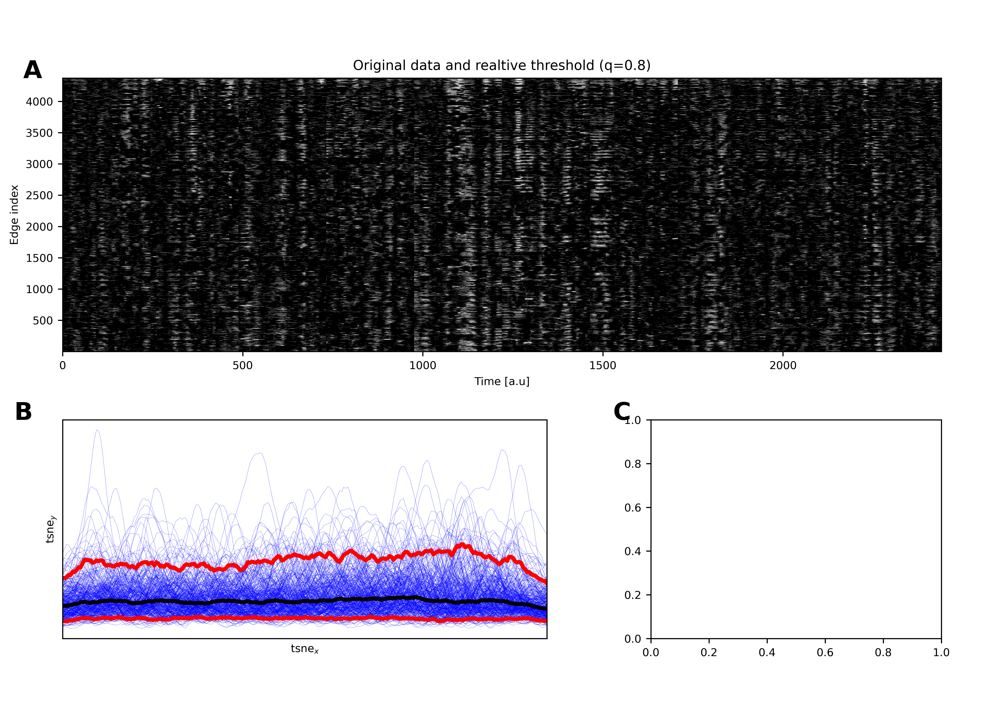

In [15]:
plot_erp_panel(_KS=0.3, _REL=True, title=r"Original data and realtive threshold (q=0.8)")

### Burstness statistics

In [20]:
def plot_q_dependece(ax, bs_stats,stats,freq,ylabel=None):
    plt.sca(ax)
    # Axis limits
    _xlim0, _xlim1 = bs_stats.thr[0],bs_stats.thr[-1]
    _ylim0, _ylim1 = bs_stats.isel(stats=stats, freqs=freq).median(dim="roi").min()-0.05, bs_stats.isel(stats=stats, freqs=freq).median(dim="roi").max()+0.05
    # Number of edges
    n_edges = bs_stats.sizes["roi"]
    # Compute the median over edges
    _median = bs_stats.isel(stats=stats,freqs=freq).median(dim="roi")
    # Compute the 5% quantile over edges
    _q005   = bs_stats.isel(stats=stats,freqs=freq).quantile(0.05, dim="roi", keep_attrs=True) #/ np.sqrt(n_edges)
    # Compute the 95% quantile over edges
    _q095   = bs_stats.isel(stats=stats,freqs=freq).quantile(0.95, dim="roi", keep_attrs=True) #/ np.sqrt(n_edges)
    for s in range(_median.sizes["stages"]):
        plt.plot(bs_stats.thr, _median.isel(stages=s))
        plt.fill_between(bs_stats.thr, 
                         _q005.isel(stages=s),
                         _q095.isel(stages=s), alpha=0.2)
    plt.vlines(bs_stats.thr.values[1], _ylim0, _ylim1, color="gray")
    plt.vlines(bs_stats.thr.values[6], _ylim0, _ylim1, ls='--', color="gray")
    plt.xlim(_xlim0, _xlim1)
    plt.ylim(_ylim0, _ylim1)
    plt.ylabel(ylabel, fontsize=MEDIUM_SIZE)

def plot_stats_dist(ax, bs_stats, stats, freq, thr, nbins, xlabel=None, legend=None):
    plt.sca(ax)
    _ylim0, _ylim1 = bs_stats.isel(stats=stats, freqs=freq).median(dim="roi").min()-0.05, bs_stats.isel(stats=stats, freqs=freq).median(dim="roi").max()+0.05
    bins=np.linspace(_ylim0, _ylim1,50)
    for i in range(bs_stats.sizes["stages"]):
        plt.hist(bs_stats.isel(stats=stats,stages=i,thr=thr, freqs=freq), bins=bins, density=True, lw=1, histtype='step', fill=False, label=stages[i], orientation='horizontal')
    if isinstance(legend, list):
        plt.legend( prop={'size': 5})
    plt.ylabel(xlabel, fontsize=MEDIUM_SIZE)

In [21]:
def plot_panel_bst(_KS=None, _SURR=False, _REL=False, title=None):
    
    bs_stats = xr.load_dataarray( get_bst_file(ks=_KS, rel=_REL, mode=mode) )
    
    
    # For the histograms of each measurement
    nbins  = 100

    fig = plt.figure(figsize=(7, 8), dpi=150)

    gs1 = fig.add_gridspec(nrows=4, ncols=3, left=0.1, right=0.95, bottom=0.05, top=0.9, wspace=0.3, hspace=.3)

    # Panel A
    ax1 = plt.subplot(gs1[0])
    ax2 = plt.subplot(gs1[3])
    ax3 = plt.subplot(gs1[6])
    ax4 = plt.subplot(gs1[9])

    #### Plotting dependence on threshold of the metrics #####
    plot_q_dependece(ax1, bs_stats, 0, slice(6,14), ylabel=_stats[0]+" [s]")
    plt.legend(stages, prop={'size': 5})
    plot_q_dependece(ax2, bs_stats, 1, slice(6,14), ylabel=_stats[1]+" [s]")
    plot_q_dependece(ax3, bs_stats, 2, slice(6,14), ylabel=_stats[2])
    plot_q_dependece(ax4, bs_stats, 3, slice(6,14), ylabel=_stats[3])
    plt.xlabel("q", fontsize=MEDIUM_SIZE)

    # Panel B
    ax5 = plt.subplot(gs1[1])
    ax6 = plt.subplot(gs1[4])
    ax7 = plt.subplot(gs1[7])
    ax8 = plt.subplot(gs1[10])

    ##### Histograms for low threshold ####
    # Mean active time
    plot_stats_dist(ax5, bs_stats, 0, slice(6,14), 1, nbins, xlabel=None, legend=stages)
    # STD of mean active time
    plot_stats_dist(ax6, bs_stats, 1, slice(6,14), 1, nbins, xlabel=None, legend=None)
    # Total active time
    plot_stats_dist(ax7, bs_stats, 2, slice(6,14), 1, nbins, xlabel=None, legend=None)
    # CV
    plot_stats_dist(ax8, bs_stats, 3, slice(6,14), 1, nbins, xlabel=None, legend=None)
    plt.xlabel("#count", fontsize=MEDIUM_SIZE)

    # Panel C
    ax9  = plt.subplot(gs1[2])
    ax10 = plt.subplot(gs1[5])
    ax11 = plt.subplot(gs1[8])
    ax12 = plt.subplot(gs1[11])

    ##### Histograms for high threshold ####
    # Mean active time
    plot_stats_dist(ax9,  bs_stats, 0, slice(6,14), 6, nbins, xlabel=None, legend=stages)
    # STD of mean active time
    plot_stats_dist(ax10, bs_stats, 1, slice(6,14), 6, nbins, xlabel=None, legend=None)
    # Total active time
    plot_stats_dist(ax11, bs_stats, 2, slice(6,14), 6, nbins, xlabel=None, legend=None)
    # CV
    plot_stats_dist(ax12, bs_stats, 3, slice(6,14), 6, nbins, xlabel=None, legend=None)
    plt.xlabel("#count", fontsize=MEDIUM_SIZE)
    
    for index in range(12):
        fig.get_axes()[index].spines['right'].set_visible(False)
        fig.get_axes()[index].spines['top'].set_visible(False)

    bg = plot.Background(visible=False)
    #bg.box((0.32, 0.65, 0.01, 0.95), lw=2)
    #bg.box((0.66, 0.99, 0.01, 0.95), lw=2, ls='--')
    bg.axes.text(0.50, 0.96, title, ha='center', fontsize=MEDIUM_SIZE);
    plot.add_panel_letters(fig, axes=[ax1, ax5, ax9], fontsize=18,
                               xpos=[-0.15,-0.15,-0.15], ypos=[1.1, 1.1, 1.1]);
    bg.hline(0.92, x0=0.407, x1=0.637, lw=2)
    bg.hline(0.92, x0=0.71, x1=0.952, lw=2, ls="--")
    plt.savefig(f"img/n5.0.0/qdependence_surr_{_SURR}_ks_{_KS}_rel_{_REL}_{mode}.png")

#### Original data and absolute threshold

In [ ]:
plot_panel_bst(_KS=0.3, _SURR=False, _REL=False, title="Burst stats. dependence on the threshold (absolute)")

#### Original data and relative threshold

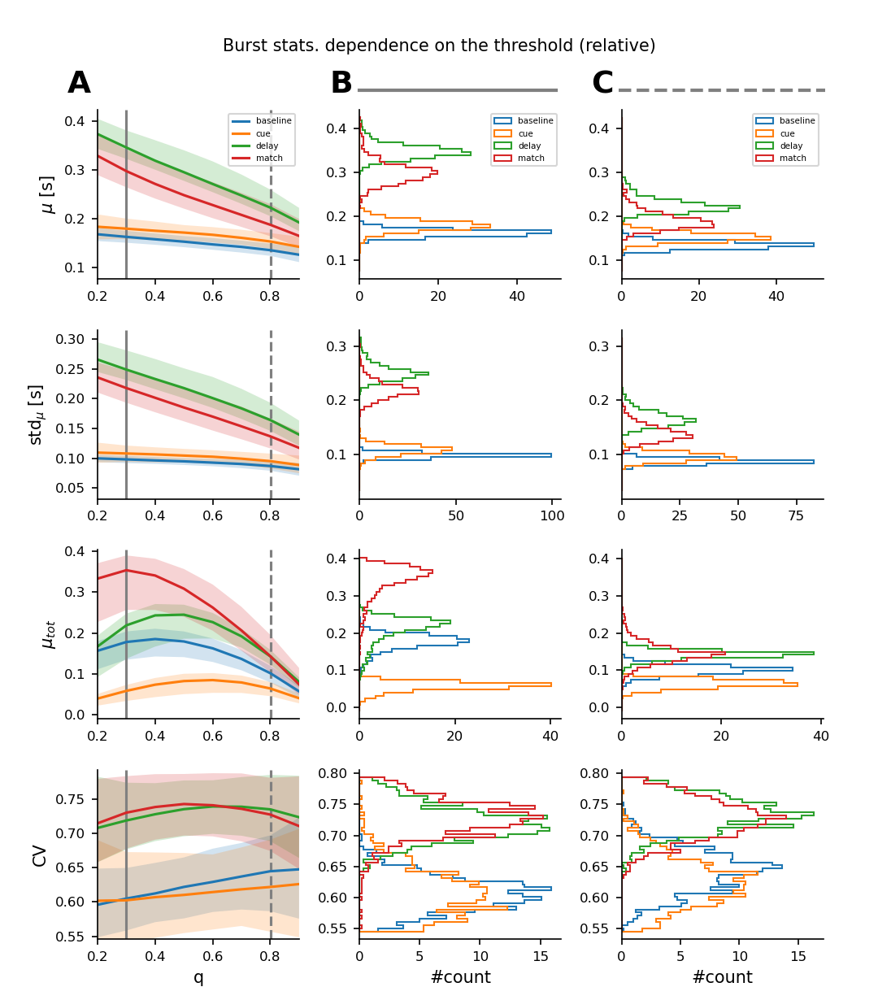

In [19]:
plot_panel_bst(_KS=500, _SURR=False, _REL=True, title="Burst stats. dependence on the threshold (relative)")

#### Surrogate data and absolute threshold

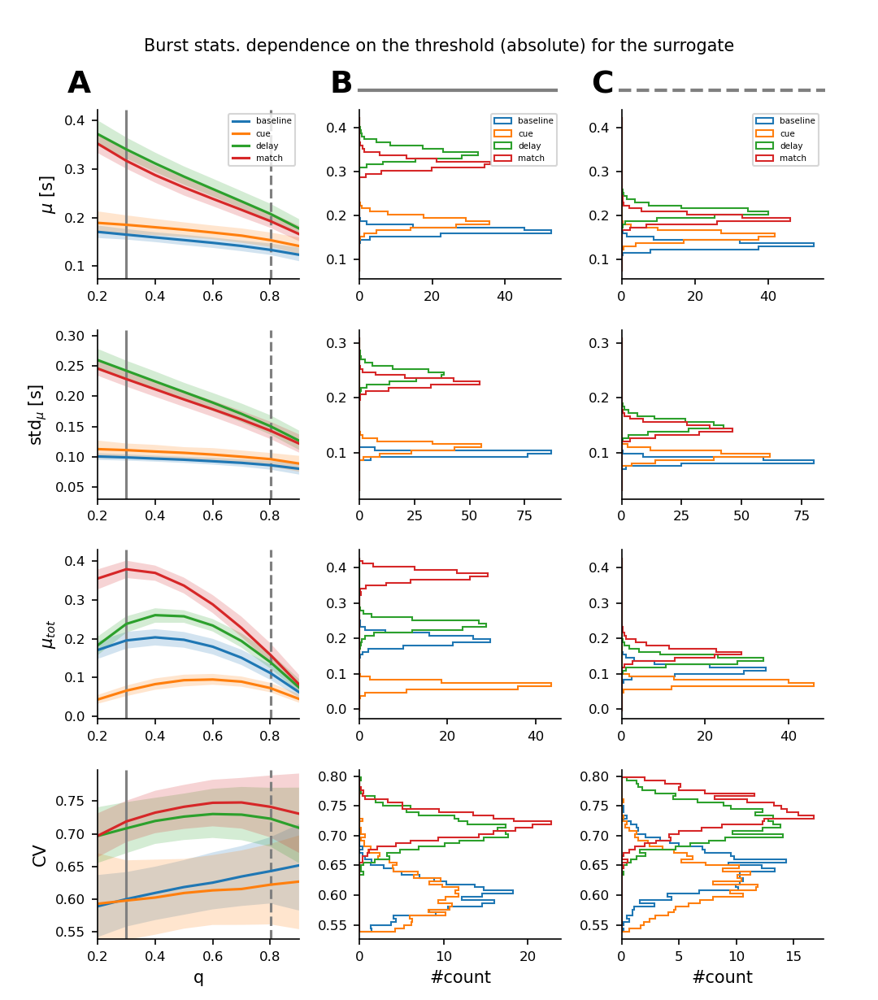

In [20]:
plot_panel_bst(_KS=500, _SURR=True, _REL=False, title="Burst stats. dependence on the threshold (absolute) for the surrogate")

#### Surrogate data and relative threshold

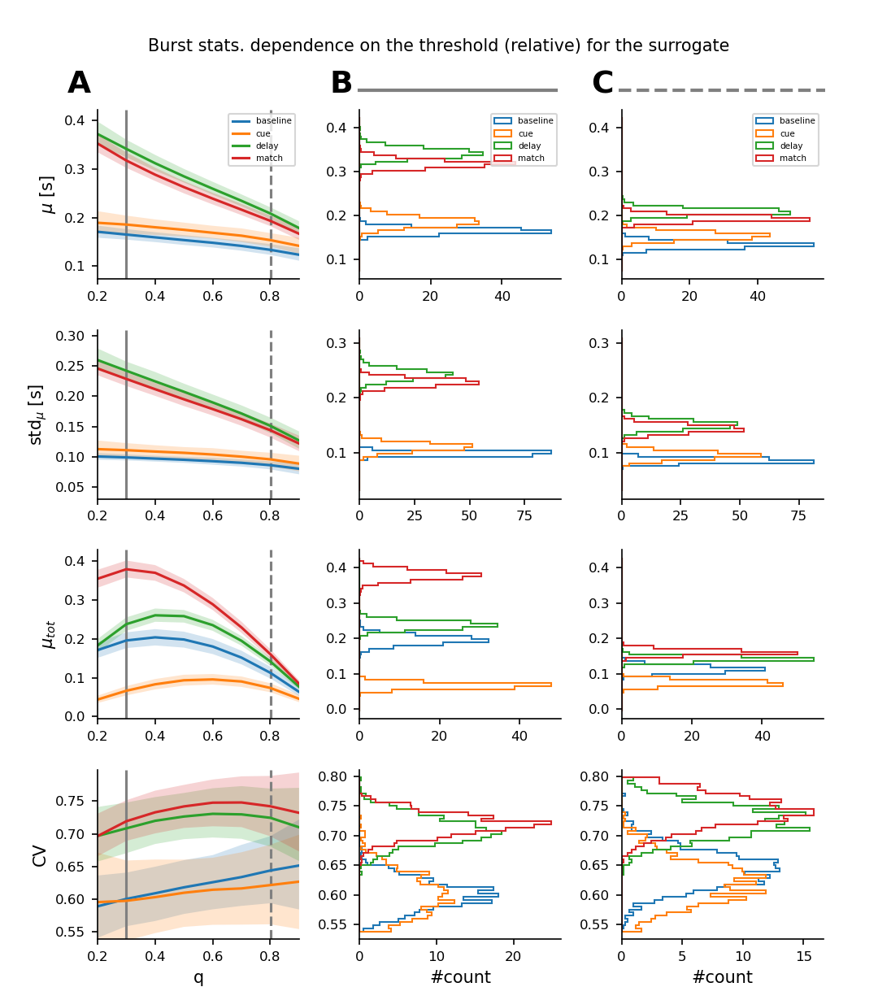

In [21]:
plot_panel_bst(_KS=500, _SURR=True, _REL=True, title="Burst stats. dependence on the threshold (relative) for the surrogate")

### Burstiness statistics - comparison with surrogates

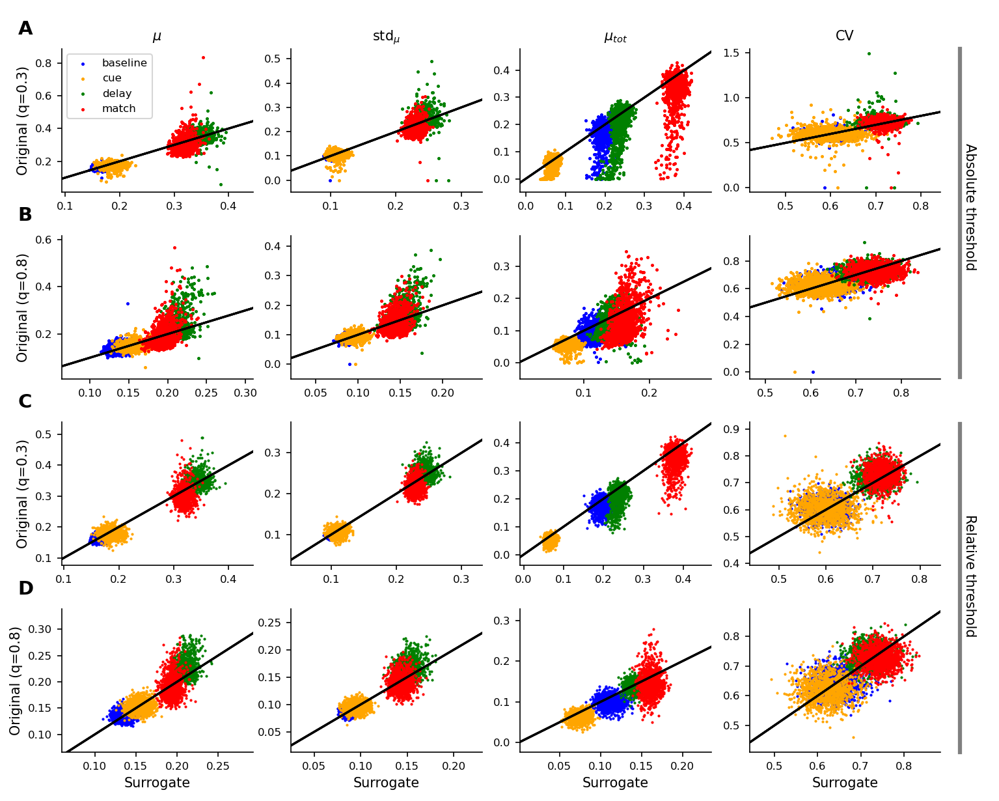

In [22]:
fig = plt.figure(figsize=(10, 8), dpi=150)

gs1 = fig.add_gridspec(nrows=4, ncols=4, left=0.05, right=0.95, bottom=0.05, top=0.95, hspace=.3)

# Panel A
ax1 = plt.subplot(gs1[0])
ax2 = plt.subplot(gs1[1])
ax3 = plt.subplot(gs1[2])
ax4 = plt.subplot(gs1[3])
ax5 = plt.subplot(gs1[4])
ax6 = plt.subplot(gs1[5])
ax7 = plt.subplot(gs1[6])
ax8 = plt.subplot(gs1[7])
ax9 = plt.subplot(gs1[8])
ax10 = plt.subplot(gs1[9])
ax11 = plt.subplot(gs1[10])
ax12 = plt.subplot(gs1[11])
ax13 = plt.subplot(gs1[12])
ax14 = plt.subplot(gs1[13])
ax15 = plt.subplot(gs1[14])
ax16 = plt.subplot(gs1[15])

c    = ['blue', 'orange', 'green', 'red']
x = np.linspace(-20,20,100)
y = x

ax_list = fig.get_axes()

#################################################################################
# Absolute threshold
#################################################################################
# Original 
bs_o = xr.load_dataarray( get_bst_file(ks=500, surr=False, rel=False) )
# Surrogate
bs_s = xr.load_dataarray( get_bst_file(ks=500, surr=True, rel=False) )

count = 0
for q in [1,6]:
    for stat in range(bs_o.sizes["stats"]):
        plt.sca(ax_list[count])
        for stage in range(bs_o.sizes["stages"]):
            plt.scatter(bs_s.isel(thr=q,stages=stage,stats=stat, freqs=1), bs_o.isel(thr=q,stages=stage,stats=stat, freqs=1), 
                        c=c[stage], s=2, label=f"{stages[stage]}")
            plt.xlim(bs_s.isel(stats=stat, thr=q, freqs=1).min()-0.05, bs_s.isel(stats=stat, thr=q, freqs=1).max()+0.05)
            plt.ylim(bs_o.isel(stats=stat, thr=q, freqs=1).min()-0.05, bs_o.isel(stats=stat, thr=q, freqs=1).max()+0.05)
            if q == 1: plt.title(f"{_stats[stat]}", fontsize=MEDIUM_SIZE)
            ax_list[count].spines['right'].set_visible(False)
            ax_list[count].spines['top'].set_visible(False)
            if stat==0: plt.ylabel(f"Original (q={np.round(bs_o.thr.values[q],2)})", fontsize=MEDIUM_SIZE)
            plt.plot(x,y, "k")
        if q==1 and stat==0: plt.legend()
        count += 1  
        
#################################################################################
# Relative threshold
#################################################################################
# Original 
bs_o = xr.load_dataarray( get_bst_file(ks=500, surr=False, rel=True) )
# Surrogate
bs_s = xr.load_dataarray( get_bst_file(ks=500, surr=True, rel=True) )        
        
for q in [1,6]:
    for stat in range(bs_o.sizes["stats"]):
        plt.sca(ax_list[count])
        for stage in range(bs_o.sizes["stages"]):
            plt.scatter(bs_s.isel(thr=q,stages=stage,stats=stat, freqs=1), bs_o.isel(thr=q,stages=stage,stats=stat, freqs=1), 
                        c=c[stage], s=1, label=f"{stages[stage]}")
            plt.xlim(bs_s.isel(stats=stat, thr=q, freqs=1).min()-0.05, bs_s.isel(stats=stat, thr=q, freqs=1).max()+0.05)
            plt.ylim(bs_o.isel(stats=stat, thr=q, freqs=1).min()-0.05, bs_o.isel(stats=stat, thr=q, freqs=1).max()+0.05)
            ax_list[count].spines['right'].set_visible(False)
            ax_list[count].spines['top'].set_visible(False)
            if stat==0: plt.ylabel(f"Original (q={np.round(bs_o.thr.values[q],2)})", fontsize=MEDIUM_SIZE)
            if q==6: plt.xlabel("Surrogate", fontsize=MEDIUM_SIZE)
            plt.plot(x,y, "k")
        count += 1 
        
plot.add_panel_letters(fig, axes=[ax1, ax5, ax9, ax13], fontsize=14,
                       xpos=[-0.23]*4, ypos=[1.1]*4);


bg = plot.Background(visible=False)
bg.vline(0.97, y0=0.53, y1=0.95, lw=3)
bg.axes.text(0.98, 0.67, "Absolute threshold", ha='center', fontsize=MEDIUM_SIZE, rotation=270)

bg.vline(0.97, y0=0.05, y1=0.47, lw=3)
bg.axes.text(0.98, 0.20, "Relative threshold", ha='center', fontsize=MEDIUM_SIZE, rotation=270)

plt.savefig("img/n5.0.0/stats_scatter_plot_or_surr.png",dpi=600)

#### Distance dependence

In [23]:
def stats_deu_dists(thr=None, stats=None, stage=None, n_bins=50, color="b", _KS=500, _SURR=False, _REL=False, mode="morlet"):
    
    bs_stats = xr.load_dataarray( get_bst_file(ks=_KS, surr=_SURR, rel=_REL, mode=mode) )
    
    # Euclidean distance for each link
    d_eu     = net.super_tensor.attrs["d_eu"]
    d_eu    /= d_eu.max()
    # Get stats for params of interest
    x        = bs_stats.isel(thr=thr, stats=stats, stages=stage, freqs=1).values
    
    plt.sca(ax)
    
    x_min, x_max = np.nanmin( bs_stats.isel(thr=thr, stats=stats, freqs=1) ), np.nanmax( bs_stats.isel(thr=thr, stats=stats, freqs=1) )
    y_min, y_max = d_eu.min(), d_eu.max()
    
    bins_x   = np.linspace(x_min, x_max, n_bins)
    bins_y   = np.linspace(y_min, y_max, n_bins)
    #plt.scatter(x, d_eu, c=color, s=.3)
    #plt.xlim([x_min-0.05,x_max+0.05])
    #plt.ylim([y_min-.05,y_max+.05])
    #plt.hist2d(x,d_eu,bins = (bins_x, bins_y))
    H, x_e, y_e = np.histogram2d(x, d_eu, bins = (bins_x, bins_y))
    
    #plt.imshow(H.T, aspect="auto", cmap="viridis", origin="lower", extent=[x_e[0],x_e[-1], y_e[0],y_e[-1]])
    return H, x_e, y_e

def plot_stats_deu_dists(ax, thr=None, stats=None, stage=None, n_bins=50,  _KS=500, _REL=False, mode="morlet"): 
    
    bs_stats      = xr.load_dataarray( get_bst_file(ks=_KS, surr=False, rel=_REL, mode=mode) )
    bs_stats_surr = xr.load_dataarray( get_bst_file(ks=_KS, surr=True, rel=_REL, mode=mode) )
    
    # Euclidean distance for each link
    d_eu     = net.super_tensor.attrs["d_eu"]
    d_eu    /= d_eu.max()
    # Get stats for params of interest
    x        = bs_stats.isel(thr=thr, stats=stats, stages=stage, freqs=1).values
    x_surr   = bs_stats_surr.isel(thr=thr, stats=stats, stages=stage, freqs=1).values
    
    plt.sca(ax)
    
    # Set bins accordingly to original data
    x_min, x_max = np.nanmin( bs_stats.isel( stats=stats, freqs=1) ), np.nanmax( bs_stats.isel(stats=stats, freqs=1) )
    y_min, y_max = d_eu.min(), d_eu.max()
    
    bins_x   = np.linspace(x_min, x_max, n_bins)
    bins_y   = np.linspace(y_min, y_max, n_bins)
    
    # Original data histogram
    #H,  x_e, y_e   = np.histogram2d(x, d_eu, bins = (bins_x, bins_y))
    
    # Surrogate data histogram
    #Hs, x_es, y_es = np.histogram2d(x_surr, d_eu, bins = (bins_x, bins_y))
    
    # Plot the difference
    #plt.imshow(H-Hs, aspect="auto", cmap="RdBu", extent=[y_e[0],y_e[-1],x_e[0],x_e[-1]], vmin=vmin, vmax=vmax)
    #plt.colorbar()
    plt.scatter(d_eu, x_surr, color="red", s=1)
    plt.scatter(d_eu, x, color="blue", s=1)
    plt.ylim([x_min-0.05,x_max+0.05])
    plt.xlim([y_min-.05,y_max+.05])

#### Absolute threshold, low threshold

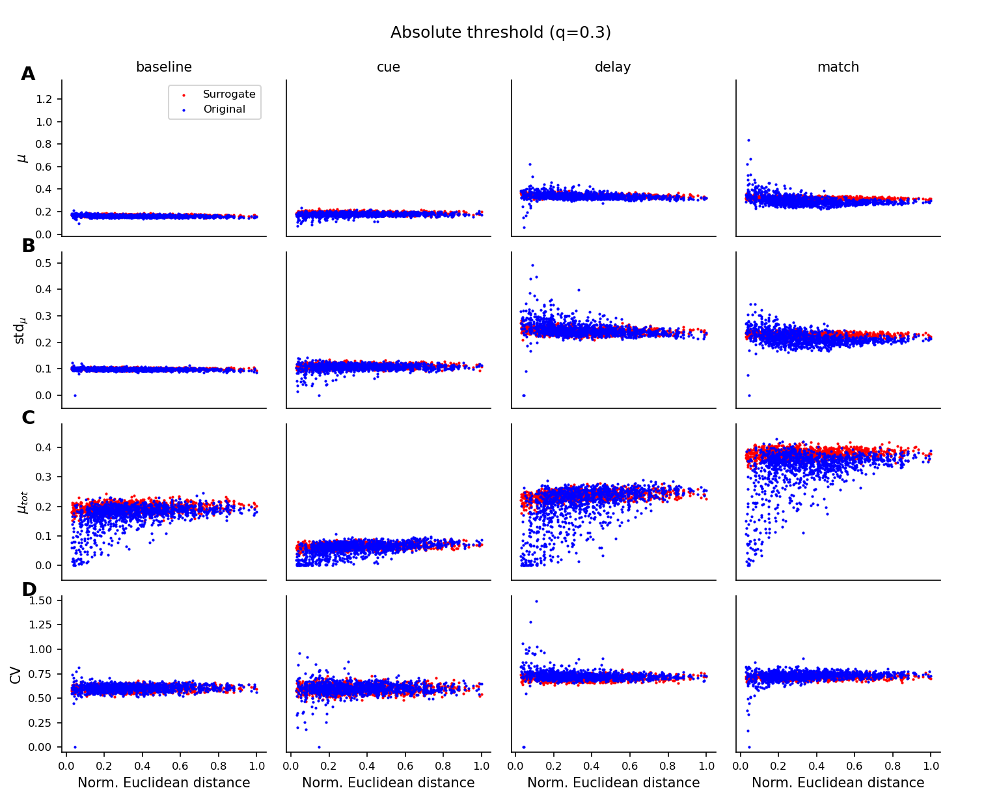

In [24]:
fig = plt.figure(figsize=(10, 8), dpi=150)

gs1 = fig.add_gridspec(nrows=1, ncols=4, left=0.05, right=0.95, bottom=0.71, top=0.91, wspace=.1)
gs2 = fig.add_gridspec(nrows=1, ncols=4, left=0.05, right=0.95, bottom=0.49, top=0.69, wspace=.1)
gs3 = fig.add_gridspec(nrows=1, ncols=4, left=0.05, right=0.95, bottom=0.27, top=0.47, wspace=.1)
gs4 = fig.add_gridspec(nrows=1, ncols=4, left=0.05, right=0.95, bottom=0.05, top=0.25, wspace=.1)


# Panel A
ax1 = plt.subplot(gs1[0])
ax2 = plt.subplot(gs1[1])
ax3 = plt.subplot(gs1[2])
ax4 = plt.subplot(gs1[3])

# Panels B
ax6 = plt.subplot(gs2[0])
ax7 = plt.subplot(gs2[1])
ax8 = plt.subplot(gs2[2])
ax9 = plt.subplot(gs2[3])

# Panels C
ax11 = plt.subplot(gs3[0])
ax12 = plt.subplot(gs3[1])
ax13 = plt.subplot(gs3[2])
ax14 = plt.subplot(gs3[3])

# Panels D
ax16 = plt.subplot(gs4[0])
ax17 = plt.subplot(gs4[1])
ax18 = plt.subplot(gs4[2])
ax19 = plt.subplot(gs4[3])

ax_list = fig.get_axes()

_THR = 1
_REL = False

count = 0
for stat in range(bs_o.sizes["stats"]):
    for stage in range(bs_o.sizes["stages"]):
        plot_stats_deu_dists(ax_list[count], thr=_THR, stats=stat, stage=stage, n_bins=50, 
                             _KS=500, _REL=_REL, mode="morlet")
        if stat  == 0: plt.title(f"{stages[stage]}", fontsize=MEDIUM_SIZE)
        if stage == 0: plt.ylabel(f"{_stats[stat]}", fontsize=MEDIUM_SIZE)
        if stat < bs_o.sizes["stats"]-1: plt.xticks([])
        if stage > 0: plt.yticks([])
        if stat == bs_o.sizes["stats"]-1: plt.xlabel("Norm. Euclidean distance")
        ax_list[count].spines['right'].set_visible(False)
        ax_list[count].spines['top'].set_visible(False)
        if stat==0 and stage==0: plt.legend(["Surrogate", "Original"])
        count += 1
        
plot.add_panel_letters(fig, axes=[ax1, ax6, ax11, ax16], fontsize=14,
                       xpos=[-0.20]*4, ypos=[1.0]*4);

plt.suptitle(f"Absolute threshold (q={np.round(bs_o.thr.values[_THR],2)})", fontsize=BIGGER_SIZE)

plt.savefig(f"img/n5.0.0/stats_distance_dependence_relative_{_REL}_q_{_THR}.png")

bg = plot.Background(visible=False)

#### Relative threshold, low threshold

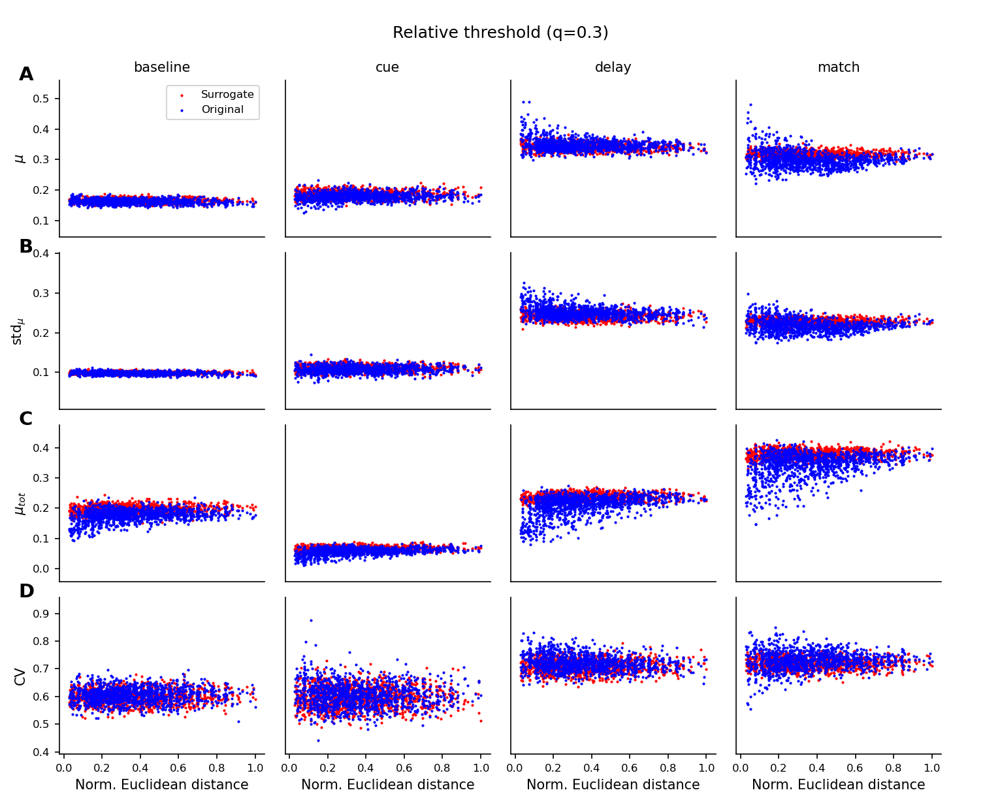

In [25]:
fig = plt.figure(figsize=(10, 8), dpi=150)

gs1 = fig.add_gridspec(nrows=1, ncols=4, left=0.05, right=0.95, bottom=0.71, top=0.91, wspace=.1)
gs2 = fig.add_gridspec(nrows=1, ncols=4, left=0.05, right=0.95, bottom=0.49, top=0.69, wspace=.1)
gs3 = fig.add_gridspec(nrows=1, ncols=4, left=0.05, right=0.95, bottom=0.27, top=0.47, wspace=.1)
gs4 = fig.add_gridspec(nrows=1, ncols=4, left=0.05, right=0.95, bottom=0.05, top=0.25, wspace=.1)


# Panel A
ax1 = plt.subplot(gs1[0])
ax2 = plt.subplot(gs1[1])
ax3 = plt.subplot(gs1[2])
ax4 = plt.subplot(gs1[3])

# Panels B
ax6 = plt.subplot(gs2[0])
ax7 = plt.subplot(gs2[1])
ax8 = plt.subplot(gs2[2])
ax9 = plt.subplot(gs2[3])

# Panels C
ax11 = plt.subplot(gs3[0])
ax12 = plt.subplot(gs3[1])
ax13 = plt.subplot(gs3[2])
ax14 = plt.subplot(gs3[3])

# Panels D
ax16 = plt.subplot(gs4[0])
ax17 = plt.subplot(gs4[1])
ax18 = plt.subplot(gs4[2])
ax19 = plt.subplot(gs4[3])

ax_list = fig.get_axes()

_THR = 1
_REL = True

count = 0
for stat in range(bs_o.sizes["stats"]):
    for stage in range(bs_o.sizes["stages"]):
        plot_stats_deu_dists(ax_list[count], thr=_THR, stats=stat, stage=stage, n_bins=50, 
                             _KS=500, _REL=_REL, mode="morlet")
        if stat  == 0: plt.title(f"{stages[stage]}", fontsize=MEDIUM_SIZE)
        if stage == 0: plt.ylabel(f"{_stats[stat]}", fontsize=MEDIUM_SIZE)
        if stat < bs_o.sizes["stats"]-1: plt.xticks([])
        if stage > 0: plt.yticks([])
        if stat == bs_o.sizes["stats"]-1: plt.xlabel("Norm. Euclidean distance")
        ax_list[count].spines['right'].set_visible(False)
        ax_list[count].spines['top'].set_visible(False)
        if stat==0 and stage==0: plt.legend(["Surrogate", "Original"])
        count += 1
        
plot.add_panel_letters(fig, axes=[ax1, ax6, ax11, ax16], fontsize=14,
                       xpos=[-0.20]*4, ypos=[1.0]*4);

plt.suptitle(f"Relative threshold (q={np.round(bs_o.thr.values[_THR],2)})", fontsize=BIGGER_SIZE)

plt.savefig(f"img/n5.0.0/stats_distance_dependence_relative_{_REL}_q_{_THR}.png")

bg = plot.Background(visible=False)

#### Absolute threshold, high threshold

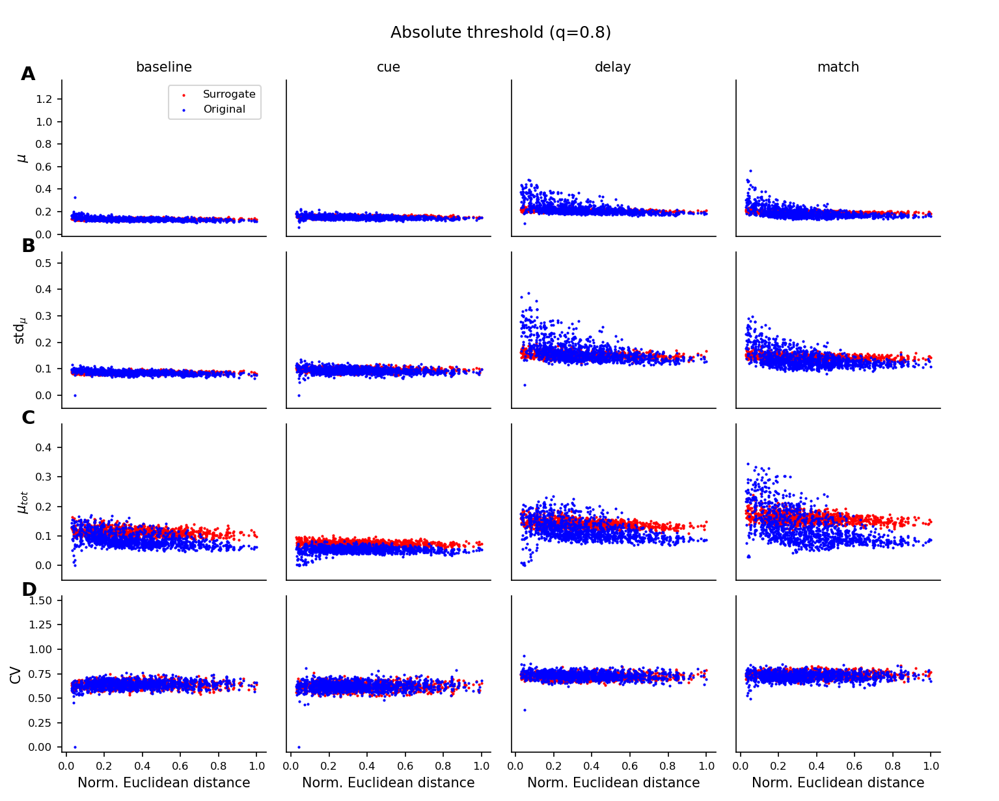

In [26]:
fig = plt.figure(figsize=(10, 8), dpi=150)

gs1 = fig.add_gridspec(nrows=1, ncols=4, left=0.05, right=0.95, bottom=0.71, top=0.91, wspace=.1)
gs2 = fig.add_gridspec(nrows=1, ncols=4, left=0.05, right=0.95, bottom=0.49, top=0.69, wspace=.1)
gs3 = fig.add_gridspec(nrows=1, ncols=4, left=0.05, right=0.95, bottom=0.27, top=0.47, wspace=.1)
gs4 = fig.add_gridspec(nrows=1, ncols=4, left=0.05, right=0.95, bottom=0.05, top=0.25, wspace=.1)


# Panel A
ax1 = plt.subplot(gs1[0])
ax2 = plt.subplot(gs1[1])
ax3 = plt.subplot(gs1[2])
ax4 = plt.subplot(gs1[3])

# Panels B
ax6 = plt.subplot(gs2[0])
ax7 = plt.subplot(gs2[1])
ax8 = plt.subplot(gs2[2])
ax9 = plt.subplot(gs2[3])

# Panels C
ax11 = plt.subplot(gs3[0])
ax12 = plt.subplot(gs3[1])
ax13 = plt.subplot(gs3[2])
ax14 = plt.subplot(gs3[3])

# Panels D
ax16 = plt.subplot(gs4[0])
ax17 = plt.subplot(gs4[1])
ax18 = plt.subplot(gs4[2])
ax19 = plt.subplot(gs4[3])

ax_list = fig.get_axes()

_THR = 6
_REL = False

count = 0
for stat in range(bs_o.sizes["stats"]):
    for stage in range(bs_o.sizes["stages"]):
        plot_stats_deu_dists(ax_list[count], thr=_THR, stats=stat, stage=stage, n_bins=50, 
                             _KS=500, _REL=_REL, mode="morlet")
        if stat  == 0: plt.title(f"{stages[stage]}", fontsize=MEDIUM_SIZE)
        if stage == 0: plt.ylabel(f"{_stats[stat]}", fontsize=MEDIUM_SIZE)
        if stat < bs_o.sizes["stats"]-1: plt.xticks([])
        if stage > 0: plt.yticks([])
        if stat == bs_o.sizes["stats"]-1: plt.xlabel("Norm. Euclidean distance")
        ax_list[count].spines['right'].set_visible(False)
        ax_list[count].spines['top'].set_visible(False)
        if stat==0 and stage==0: plt.legend(["Surrogate", "Original"])
        count += 1
        
plot.add_panel_letters(fig, axes=[ax1, ax6, ax11, ax16], fontsize=14,
                       xpos=[-0.20]*4, ypos=[1.0]*4);

plt.suptitle(f"Absolute threshold (q={np.round(bs_o.thr.values[_THR],2)})", fontsize=BIGGER_SIZE)

plt.savefig(f"img/n5.0.0/stats_distance_dependence_relative_{_REL}_q_{_THR}.png")

bg = plot.Background(visible=False)

#### Relative threshold, high threshold

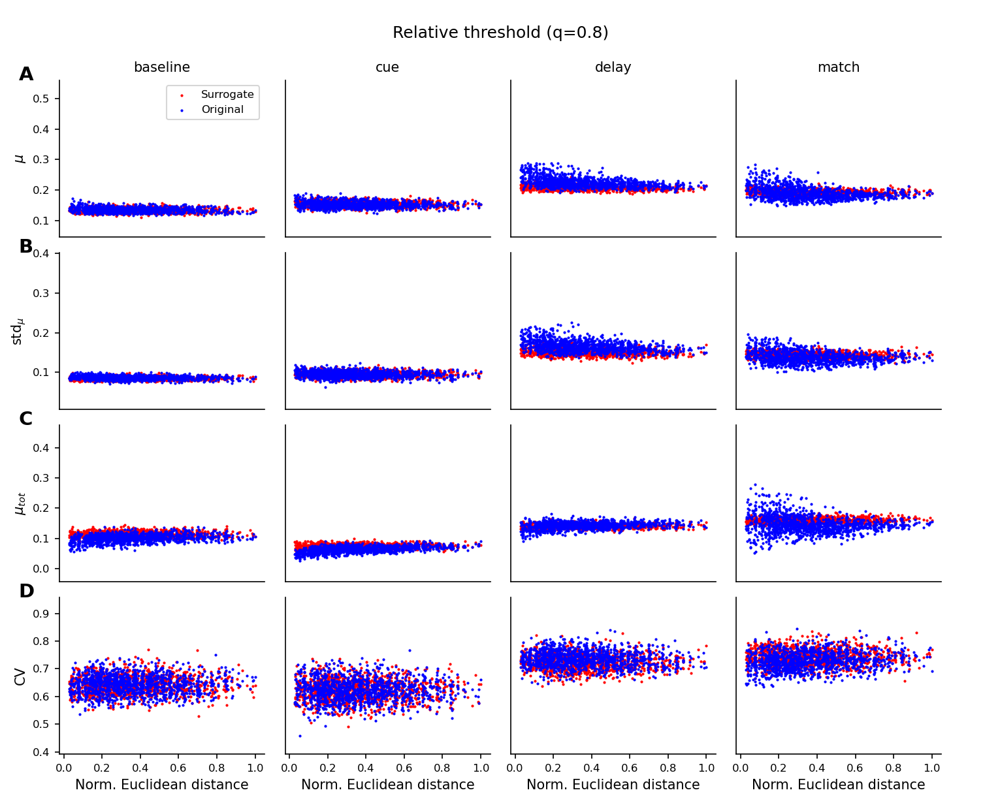

In [27]:
fig = plt.figure(figsize=(10, 8), dpi=150)

gs1 = fig.add_gridspec(nrows=1, ncols=4, left=0.05, right=0.95, bottom=0.71, top=0.91, wspace=.1)
gs2 = fig.add_gridspec(nrows=1, ncols=4, left=0.05, right=0.95, bottom=0.49, top=0.69, wspace=.1)
gs3 = fig.add_gridspec(nrows=1, ncols=4, left=0.05, right=0.95, bottom=0.27, top=0.47, wspace=.1)
gs4 = fig.add_gridspec(nrows=1, ncols=4, left=0.05, right=0.95, bottom=0.05, top=0.25, wspace=.1)


# Panel A
ax1 = plt.subplot(gs1[0])
ax2 = plt.subplot(gs1[1])
ax3 = plt.subplot(gs1[2])
ax4 = plt.subplot(gs1[3])

# Panels B
ax6 = plt.subplot(gs2[0])
ax7 = plt.subplot(gs2[1])
ax8 = plt.subplot(gs2[2])
ax9 = plt.subplot(gs2[3])

# Panels C
ax11 = plt.subplot(gs3[0])
ax12 = plt.subplot(gs3[1])
ax13 = plt.subplot(gs3[2])
ax14 = plt.subplot(gs3[3])

# Panels D
ax16 = plt.subplot(gs4[0])
ax17 = plt.subplot(gs4[1])
ax18 = plt.subplot(gs4[2])
ax19 = plt.subplot(gs4[3])

ax_list = fig.get_axes()

_THR = 6
_REL = True

count = 0
for stat in range(bs_o.sizes["stats"]):
    for stage in range(bs_o.sizes["stages"]):
        plot_stats_deu_dists(ax_list[count], thr=_THR, stats=stat, stage=stage, n_bins=50, 
                             _KS=500, _REL=_REL, mode="morlet")
        if stat  == 0: plt.title(f"{stages[stage]}", fontsize=MEDIUM_SIZE)
        if stage == 0: plt.ylabel(f"{_stats[stat]}", fontsize=MEDIUM_SIZE)
        if stat < bs_o.sizes["stats"]-1: plt.xticks([])
        if stage > 0: plt.yticks([])
        if stat == bs_o.sizes["stats"]-1: plt.xlabel("Norm. Euclidean distance")
        ax_list[count].spines['right'].set_visible(False)
        ax_list[count].spines['top'].set_visible(False)
        if stat==0 and stage==0: plt.legend(["Surrogate", "Original"])
        count += 1
        
plot.add_panel_letters(fig, axes=[ax1, ax6, ax11, ax16], fontsize=14,
                       xpos=[-0.20]*4, ypos=[1.0]*4);

plt.suptitle(f"Relative threshold (q={np.round(bs_o.thr.values[_THR],2)})", fontsize=BIGGER_SIZE)

plt.savefig(f"img/n5.0.0/stats_distance_dependence_relative_{_REL}_q_{_THR}.png")

bg = plot.Background(visible=False)

### Single-link plot of the stats

In [28]:
###################################################################################
# Convert array with links stats to matrix (roi, roi)
###################################################################################
def get_stats_mat(_REL=False):

    # Original 
    bs_o = xr.load_dataarray( get_bst_file(ks=500, surr=False, rel=_REL) )
    # Surrogate
    bs_s = xr.load_dataarray( get_bst_file(ks=500, surr=True, rel=_REL) )
    
    x_s, x_t = net.super_tensor.attrs["sources"], net.super_tensor.attrs["targets"]
    
    size = (bs_s.sizes["thr"],bs_o.sizes["stats"], bs_o.sizes["stages"], net.super_tensor.attrs["nC"],net.super_tensor.attrs["nC"])
    
    bs_mat      = np.zeros(size)
    bs_mat_surr = np.zeros(size)
    
    for q in range(bs_s.sizes["thr"]):
        for s in range(bs_s.sizes["stats"]):
            for st in range(bs_s.sizes["stages"]):
                for p, (i,j) in enumerate( zip(x_s, x_t) ):
                    bs_mat[q,s,st,i,j]      = bs_mat[q,s,st,j,i]      = bs_o.isel(thr=q,stages=st,stats=s,freqs=1,roi=p).values
                    bs_mat_surr[q,s,st,i,j] = bs_mat_surr[q,s,st,j,i] = bs_s.isel(thr=q,stages=st,stats=s,freqs=1,roi=p).values
            
    return bs_mat, bs_mat_surr

In [29]:
###################################################################################
# Defining plot functions
###################################################################################
def plot_conn_sig(data, thr, sidx, stidx, surr=False, top=20, _colorbar=False, _title=False, subplot=111):
    """
    Plot connectivity circle with links with top
    signigicant coherence distribution for a given band
    """
    
    if _title: title=f"{_stats[sidx]}"
    else: title=None
    
    fig = plt.figure(figsize=(5,5))
    plot_connectivity_circle(data[thr,sidx,stidx], net.super_tensor.attrs["areas"], colormap="hot_r", vmin=0, vmax=data[:,sidx].mean()/2, 
                             facecolor="white", n_lines=top, textcolor="k", fig=fig, colorbar=_colorbar, padding=1, linewidth=2,
                             title=title, fontsize_title=20,fontsize_names=12, subplot=subplot, show=False);
    plt.savefig(f"img/n5.0.0/top_stats_{sidx}__stages_{stidx}_thr_{thr}_surr_{surr}_top_{top}.png", transparent=True, bbox_inches='tight', dpi=300)
    plt.close()
    
def plot_circles(ax, thr, sidx, stidx, surr, top=20):
    """
    Plot olympics circles to the given axes.
    """
    
    png = plt.imread(f"img/n5.0.0/top_stats_{sidx}__stages_{stidx}_thr_{thr}_surr_{surr}_top_{top}.png")
    plt.sca(ax)
    im = plt.imshow(png, interpolation='none')
    #plt.axis('off')    
    pad = 2
    plt.xlim(-pad, png.shape[1]+pad)
    plt.ylim(png.shape[0]+pad, -pad)
    return png

### Absolute threshold

In [30]:
_REL = False

In [31]:
bs_mat, bs_mat_surr = get_stats_mat(_REL=_REL)

In [32]:
for q in [0,4,7]:
    for s in range(bs_o.sizes["stats"]):
        for st in range(bs_o.sizes["stages"]):
            plot_conn_sig(bs_mat, q, s, st, surr=False, top=20, _colorbar=False, _title=False, subplot=111);
            plot_conn_sig(bs_mat_surr, q, s, st, surr=True, top=20, _colorbar=False, _title=False, subplot=111);

/home/vinicius/.local/lib/python3.8/site-packages/mne/viz/circle.py:305: RuntimeWarning: invalid value encountered in greater_equal
  con_draw_idx = np.where(con_abs >= con_thresh)[0]


In [33]:
def plot_conn_stage(stage, surr,top):
    fig = plt.figure(figsize=(6,8), dpi=300)

    gs1 = fig.add_gridspec(nrows=4, ncols=3, left=0.05, right=0.95, bottom=0.05, top=0.90, wspace=0.01, hspace=0.01)

    # Panel A
    ax1 = plt.subplot(gs1[0])
    ax2 = plt.subplot(gs1[1])
    ax3 = plt.subplot(gs1[2])
    ax4 = plt.subplot(gs1[3])
    ax5 = plt.subplot(gs1[4])
    ax6 = plt.subplot(gs1[5])
    ax7 = plt.subplot(gs1[6])
    ax8 = plt.subplot(gs1[7])
    ax9 = plt.subplot(gs1[8])
    ax10 = plt.subplot(gs1[9])
    ax11 = plt.subplot(gs1[10])
    ax12 = plt.subplot(gs1[11])

    ax_list = fig.get_axes()

    count=1
    for s in range(bs_o.sizes["stats"]):
        for q in [0,4,7]:
            plot_circles(ax_list[count-1], q, s, stage, surr, top=top) 
            if s==0: 
                plt.title(f"q={np.round(bs_o.thr.values[q],2)}", fontsize=MEDIUM_SIZE)
            if q==0: 
                plt.ylabel(_stats[s], fontsize=MEDIUM_SIZE)
            ax_list[count-1].set_yticklabels([])
            ax_list[count-1].set_xticklabels([])
            ax_list[count-1].set_xticks([])
            ax_list[count-1].set_yticks([])
            ax_list[count-1].spines['top'].set_visible(False)
            ax_list[count-1].spines['bottom'].set_visible(False)
            ax_list[count-1].spines['left'].set_visible(False)
            ax_list[count-1].spines['right'].set_visible(False)
            count += 1   

    plot.add_panel_letters(fig, axes=[ax1, ax4, ax7, ax10], fontsize=14,
                       xpos=[-0.1]*4, ypos=[0.9]*4);
    if surr: plt.suptitle(f"Absolute threshold, {stages[stage]} (surrogate)", fontsize=SMALL_SIZE)
    else: plt.suptitle(f"Absolute threshold, {stages[stage]}", fontsize=SMALL_SIZE)
    bg = plot.Background(visible=False)
    plt.savefig(f"img/n5.0.0/top_stages_{stage}_surr_{surr}_top_{top}.png", transparent=True, bbox_inches='tight', dpi=300)

#### Baseline original

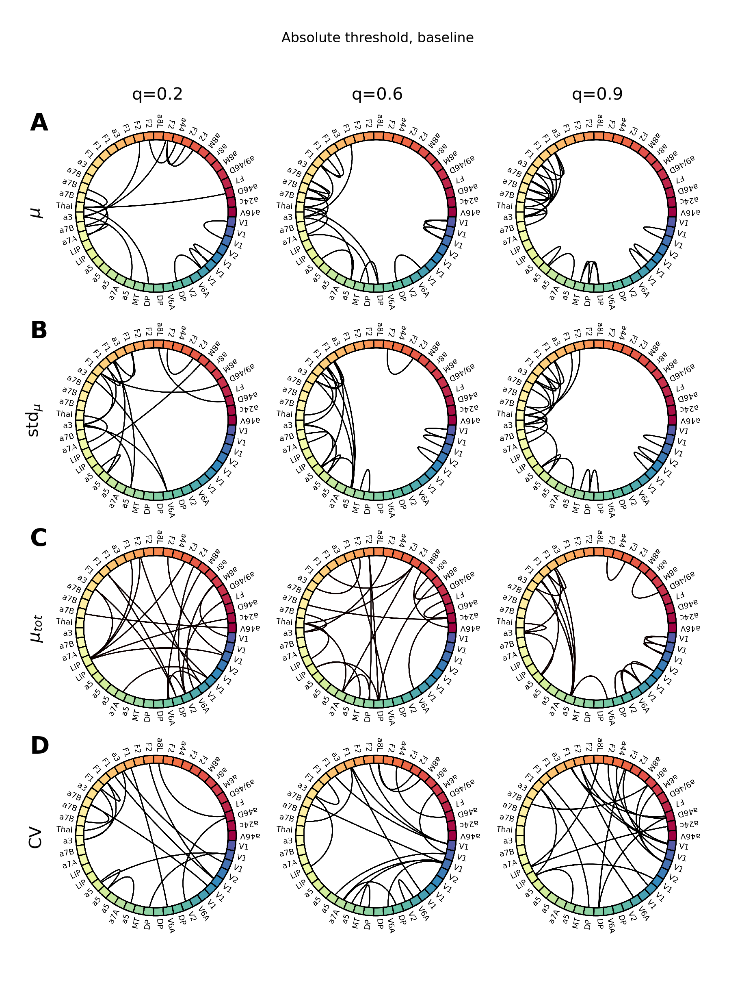

In [34]:
plot_conn_stage(0, False,20)

#### Baseline surrogate

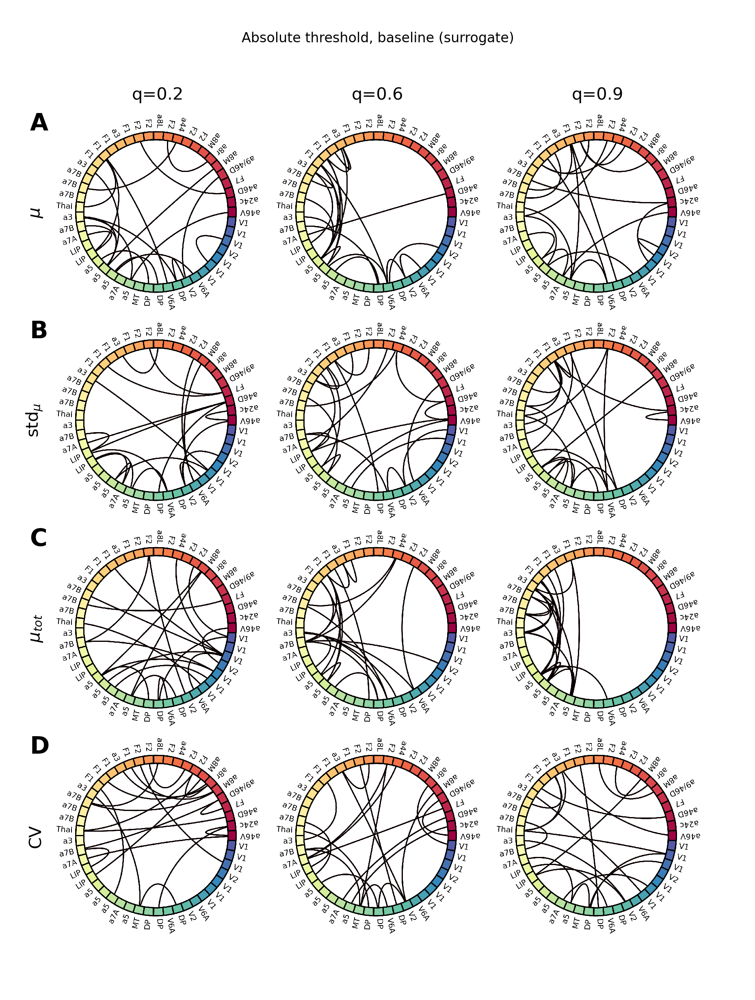

In [35]:
plot_conn_stage(0, True,20)

#### Cue original

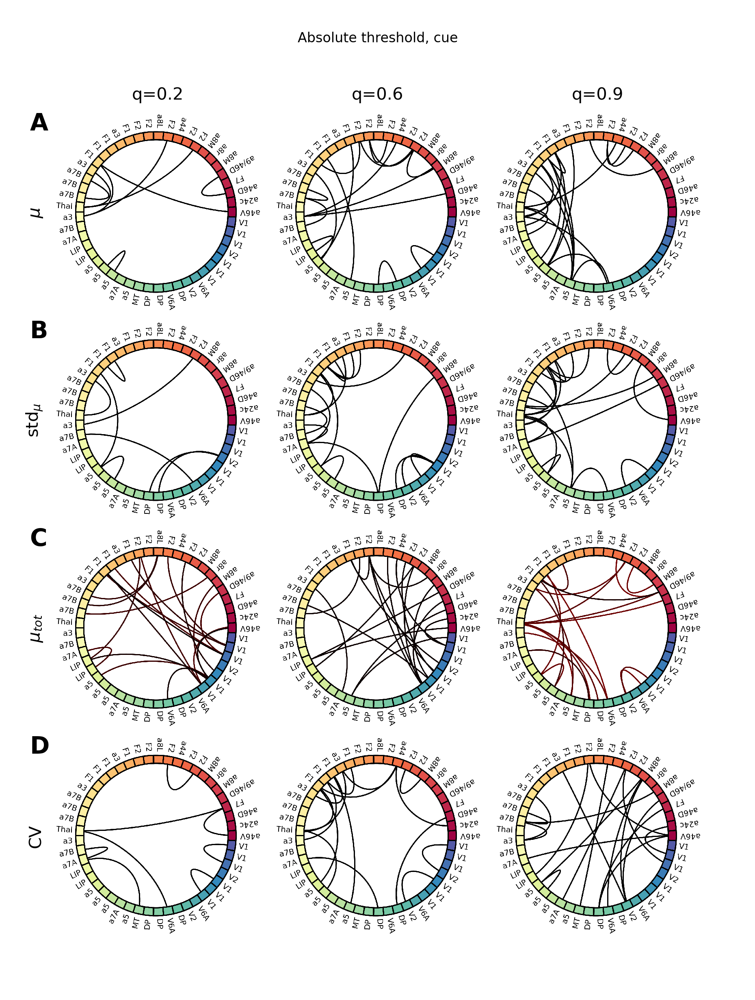

In [36]:
plot_conn_stage(1, False,20)

#### Cue surrogate

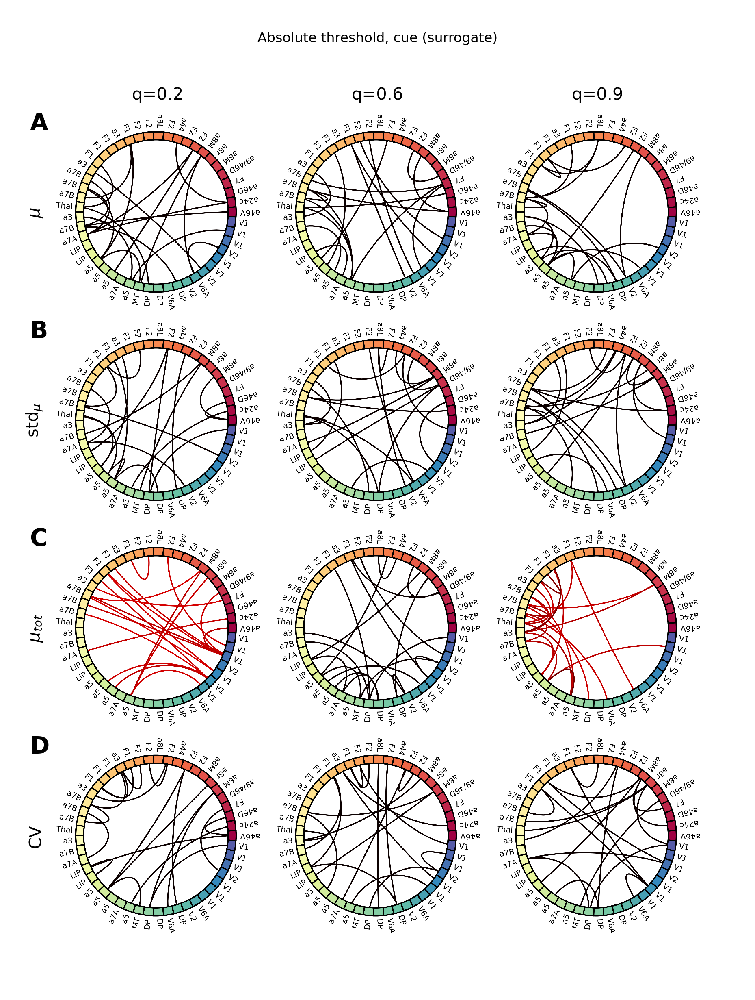

In [37]:
plot_conn_stage(1, True,20)

#### Delay original

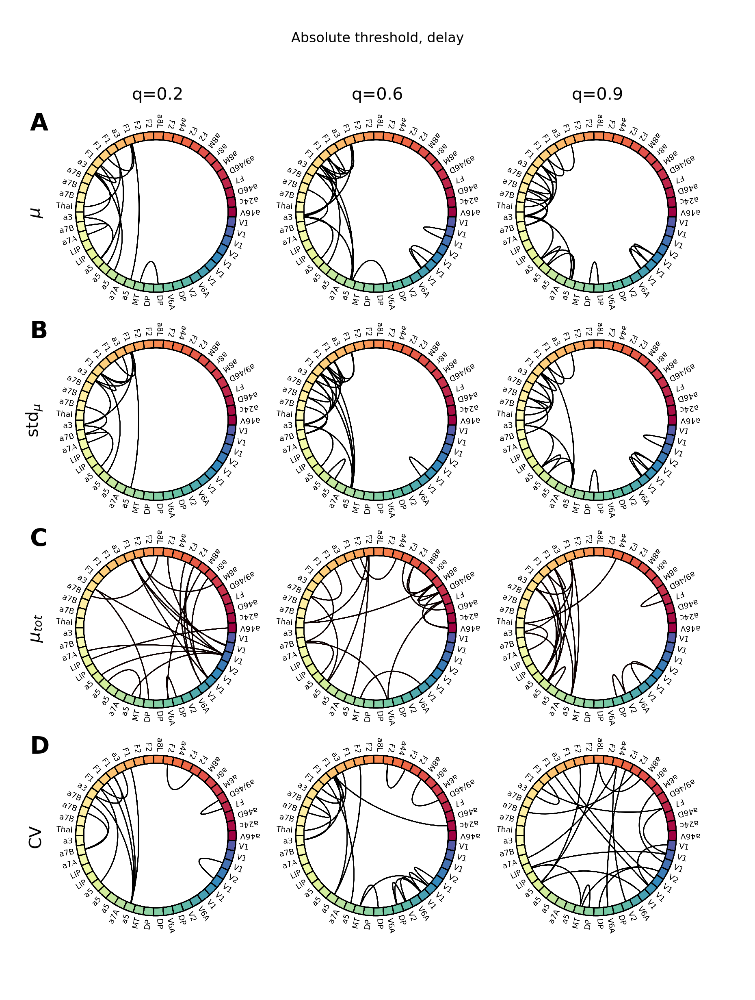

In [38]:
plot_conn_stage(2, False,20)

#### Delay surrogate

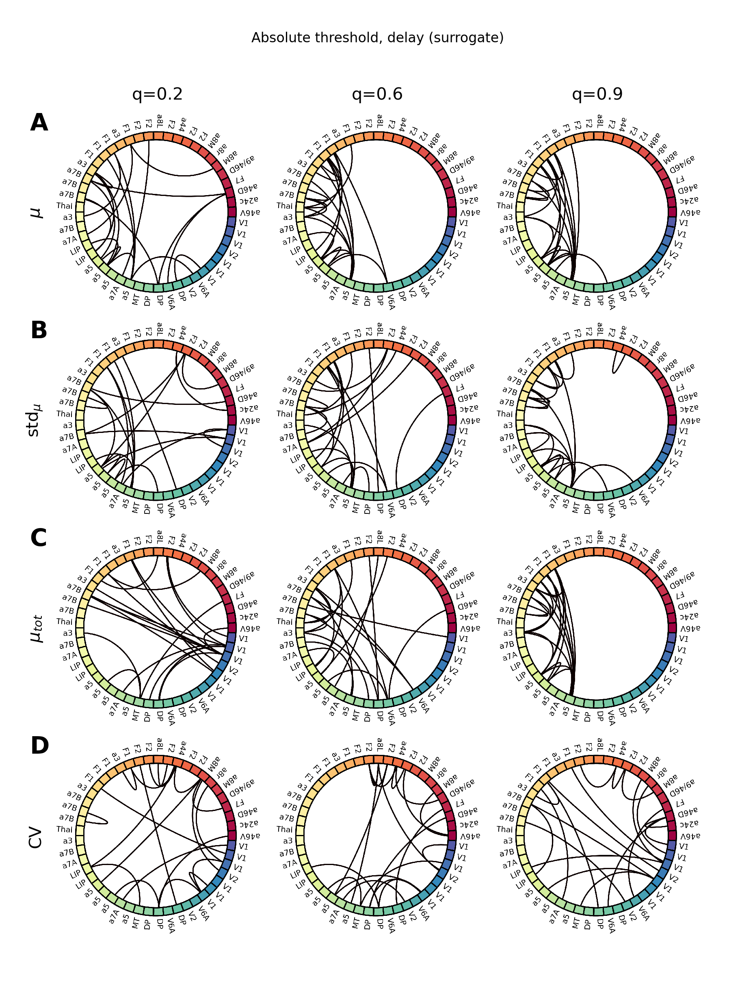

In [39]:
plot_conn_stage(2, True,20)

#### Match original

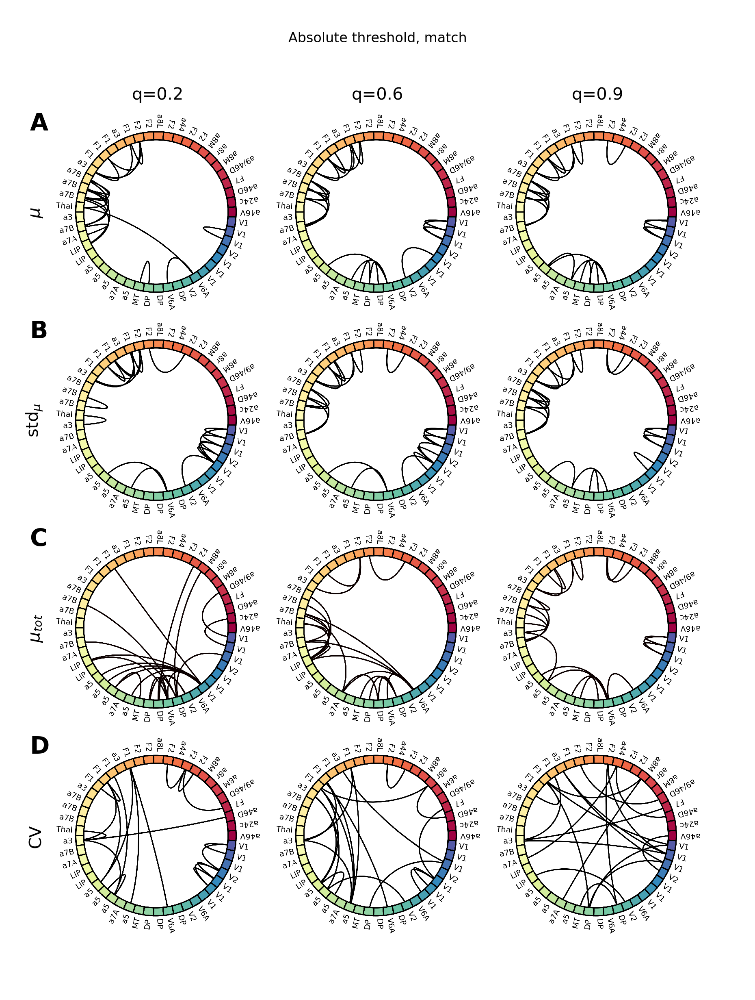

In [40]:
plot_conn_stage(3, False,20)

#### Match surrogate

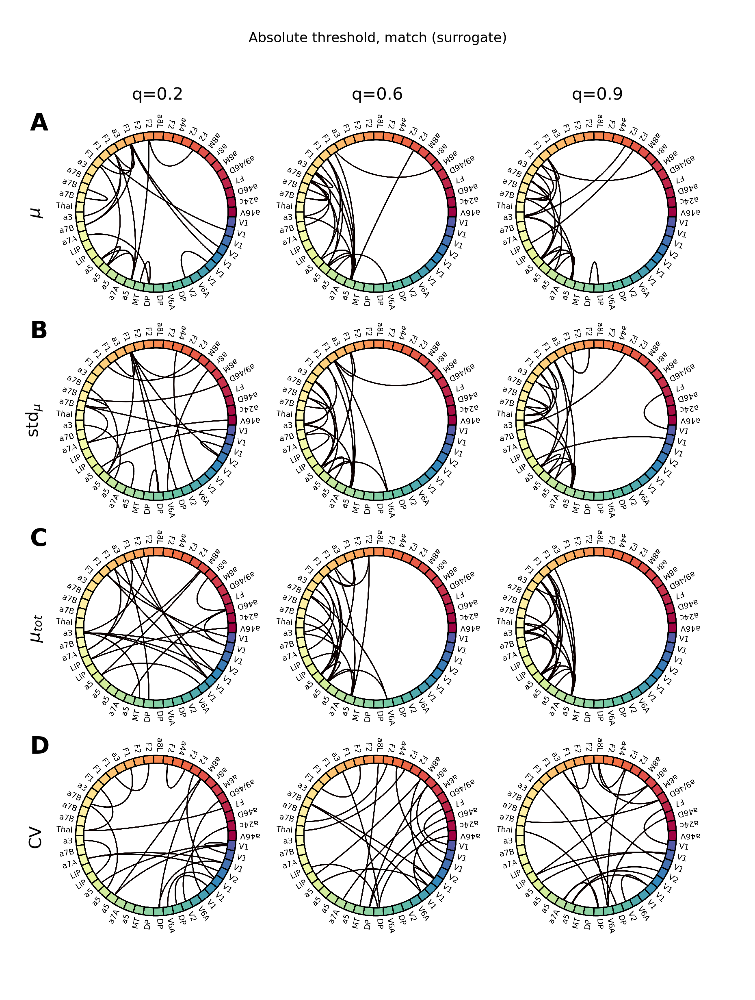

In [41]:
plot_conn_stage(3,True,20)

In [255]:
bs_stats = xr.load_dataarray( get_bst_file(ks=0.3, mode="morlet") )

In [264]:
bs_stats

<xarray.DataArray (zeros: 2, freqs: 10, roi: 4371, stages: 4, stats: 4)>
array([[[[[ 0.14012019,  0.11254213,  0.13300931, -0.10914989],
          [ 0.12522936,  0.08319146,  0.08061658, -0.20169721],
          [ 0.17291066,  0.13236989,  0.14371946, -0.13279842],
          [ 0.18325737,  0.14123751,  0.16704545, -0.12949313]],

         [[ 0.12388889,  0.09794493,  0.07632804, -0.11695221],
          [ 0.10580645,  0.07012773,  0.05811481, -0.20279587],
          [ 0.14528926,  0.11224199,  0.0842196 , -0.12832334],
          [ 0.15953674,  0.12644763,  0.12203079, -0.11570252]],

         [[ 0.14703488,  0.10317314,  0.11541621, -0.17530112],
          [ 0.1453125 ,  0.10094261,  0.09611977, -0.18017854],
          [ 0.17045455,  0.1278498 ,  0.12575453, -0.14282306],
          [ 0.17693277,  0.13817707,  0.15436217, -0.12299109]],

         ...,

         [[ 0.18387833,  0.14745875,  0.22070099, -0.10991699],
          [ 0.14057522,  0.10029989,  0.09381644, -0.16720422],
          [ 0.20611675,  0.14093063,  0.19452429, -0.1878306 ],
...
          [ 0.40064789,  0.16472342,  0.84000709, -0.41729119],
          [ 0.79678186,  0.44209497,  0.8836591 , -0.28629714],
          [ 0.81354077,  0.43099684,  0.92646628, -0.30737836]],

         ...,

         [[ 0.5062406 ,  0.2128816 ,  0.92182366, -0.40794041],
          [ 0.41351695,  0.15941007,  0.86454642, -0.44352398],
          [ 0.78071895,  0.43672632,  0.85836447, -0.28255286],
          [ 0.81136957,  0.42976128,  0.91209677, -0.30746822]],

         [[ 0.46020833,  0.22196321,  0.90731106, -0.34924519],
          [ 0.42594183,  0.15020005,  0.90813253, -0.47860048],
          [ 0.74982107,  0.44956138,  0.90342052, -0.25034524],
          [ 0.70258979,  0.43261569,  0.90828446, -0.23781959]],

         [[ 0.46378282,  0.22122397,  0.88684283, -0.35409699],
          [ 0.40890411,  0.16156691,  0.88146704, -0.43356663],
          [ 0.69189655,  0.43982738,  0.86511929, -0.22273026],
          [ 0.72017787,  0.42660424,  0.89054252, -0.25599774]]]]])
Coordinates:
  * zeros    (zeros) int64 0 1
  * freqs    (freqs) float64 3.0 11.0 19.0 27.0 35.0 43.0 51.0 59.0 67.0 75.0
  * roi      (roi) object 'a46D-a8B' 'a46D-F6' 'a46D-a9/46D' ... 'V1-V1' 'V1-V1'
  * stages   (stages) object 'baseline' 'cue' 'delay' 'match'
  * stats    (stats) object '$\\mu$' 'std$_{\\mu}$' '$\\mu_{tot}$' 'CV'
Attributes: (12/21)
    nC:               94
    fsample:          1000.0
    channels_labels:  [  1   4   8   9  10  11  12  13  14  15  16  17  18  1...
    stim:             [4. 2. 1. 2. 1. 2. 2. 1. 2. 2. 2. 4. 5. 3. 3. 5. 2. 1. ...
    indch:            [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 ...
    t_cue_on:         [1063. 1015.  829. 1055.  878. 1049.  838.  959. 1021. ...
    ...               ...
    n_cycles:         [ 1.5  5.5  9.5 13.5 17.5 21.5 25.5 29.5 33.5 37.5]
    mt_bandwidth:     None
    decim:            15
    type:             coh
    areas:            ['a46D', 'a8B', 'F6', 'a9/46D', 'a8M', 'a8B', 'a8B', 'F...
    d_eu:             [ 89.05054744 116.09048195  89.47066558 ...  82.0243866...